In [1]:
import cupy as cp
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import cv2
import xraylib
import random
import cupyx.scipy.ndimage as ndimage
from types import SimpleNamespace
import warnings
warnings.filterwarnings("ignore", message=f".*peer.*")

from utils import *
from rec import Rec

## Sizes and propagation settings

In [2]:
# sizes
n = 1024  # detector size in each dimension
ncode = 2048 # size of the CA, should be bigger than the object since we move CA
npos = 16 # number of position for the CA
ngpus = 4
nchunk = 4
# propagation parameters
detector_pixelsize = 3.03751e-6 # [m] detector pixel size
energy = 33.35  # [keV] xray energy
wavelength = 1.24e-09/energy  # [m] wave length
focusToDetectorDistance = 1.28  # [m]
z1 = 10.3e-3 # [m] position of the sample
z1c = -17.5e-3 # [m] position of the CA
z2 = focusToDetectorDistance-z1
distance = (z1*z2)/focusToDetectorDistance
distancec = (z1-z1c)/(z1c/z1)
magnification = focusToDetectorDistance/z1
magnifications2 = z1/z1c
voxelsize = np.abs(detector_pixelsize/magnification)  # object voxel size
ex = 16 # extra pad for extracting patches

In [3]:
args = SimpleNamespace()

args.ngpus = ngpus
args.n = n
args.ncode = ncode
args.pad = 0
args.npsi = args.n + 2 * args.pad
args.ex = 0
args.npatch = args.npsi + 2 * args.ex
args.npos = npos
args.nchunk = nchunk
args.voxelsize = voxelsize
args.wavelength = wavelength
args.distance = distance
args.distancec = distancec

# create class
cl_rec = Rec(args)

## Generate positions of the CA

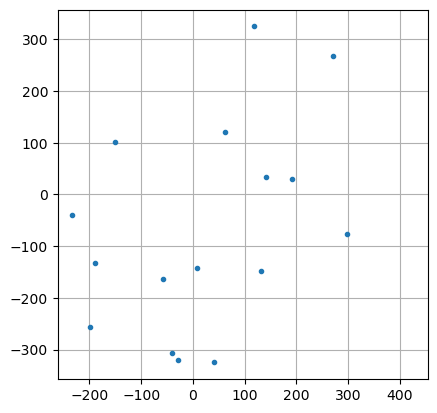

In [4]:
np.random.seed(3)
pos = (np.random.random([npos,2]).astype('float32')-0.5)*ncode/3
mplot_positions(pos)

## Load probe

File ‘prb_abs_2048.tiff’ already there; not retrieving.

File ‘prb_phase_2048.tiff’ already there; not retrieving.



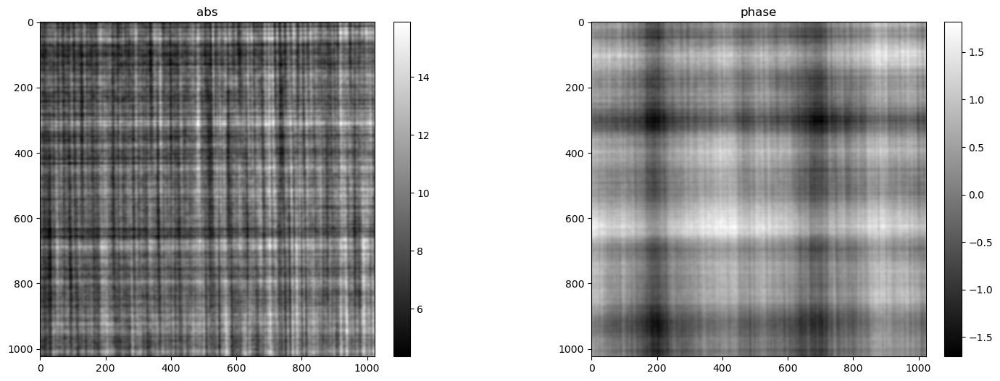

In [14]:
!wget -nc https://g-110014.fd635.8443.data.globus.org/holotomocupy/examples_synthetic/data/prb_id16a/prb_abs_2048.tiff 
!wget -nc https://g-110014.fd635.8443.data.globus.org/holotomocupy/examples_synthetic/data/prb_id16a/prb_phase_2048.tiff 

q_abs = read_tiff(f'prb_abs_2048.tiff')[0,1024-args.npsi//2:1024+args.npsi//2,1024-args.npsi//2:1024+args.npsi//2]
q_phase = read_tiff(f'prb_phase_2048.tiff')[0,1024-args.npsi//2:1024+args.npsi//2,1024-args.npsi//2:1024+args.npsi//2]
q = cp.array(q_abs*np.exp(1j*q_phase)).astype('complex64')

#smooth it slightly
v = cp.arange(-args.npsi//2,args.npsi//2)/args.npsi
[vx,vy] = cp.meshgrid(v,v)
v = cp.exp(-200*(vx**2+vy**2))
fq = cp.fft.fftshift(cp.fft.fftn(cp.fft.fftshift(q)))
q = cp.fft.fftshift(cp.fft.ifftn(cp.fft.fftshift(fq*v))).astype('complex64')
q = q.get()
mshow_polar(q)


## generate coded aperture

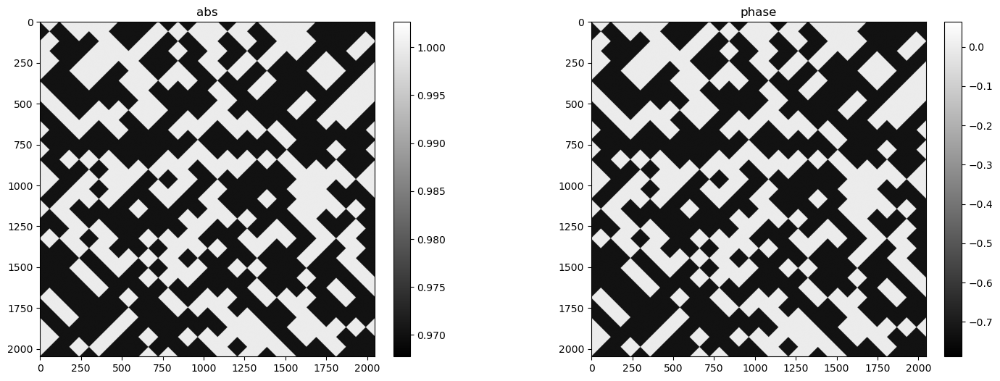

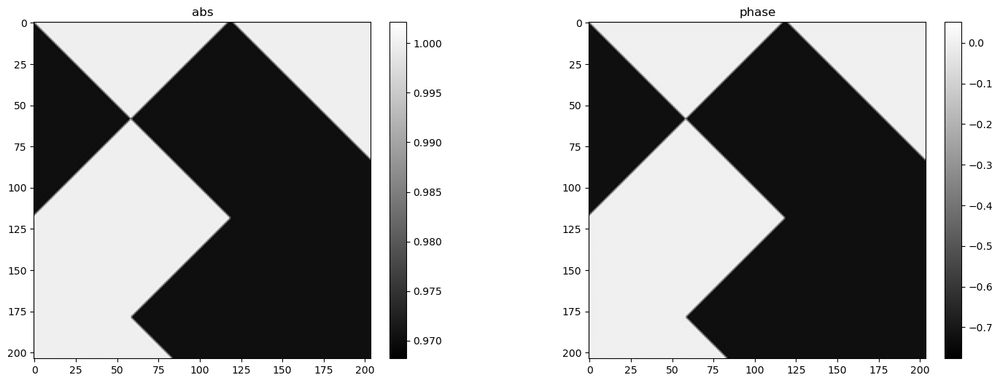

In [6]:
bin_size = 2e-6
code_thickness = 1.5e-6

random.seed(10)
nill = 2*args.ncode
ill_global = cp.zeros([nill,nill],dtype='bool')
ill0 = cp.zeros([nill*nill],dtype='bool')
ill_ids = random.sample(range(0, nill*nill), int(nill*nill*0.55))
ill0[ill_ids] = 1
ill_global = ill0.reshape(nill,nill)

# form codes for simulations
nill = int((args.ncode*voxelsize)//(bin_size*2))*2
ill = cp.zeros([nill,nill],dtype='bool')
ill0 = ill_global
ill = ill0[ill0.shape[0]//2-nill//2:ill0.shape[0]//2+(nill)//2,
                ill0.shape[1]//2-nill//2:ill0.shape[1]//2+(nill)//2]#.reshape(nill,nill)

ill = ndimage.zoom(ill,args.ncode/nill,order=0,grid_mode=True,mode='grid-wrap')

delta = 1-xraylib.Refractive_Index_Re('Au',energy,19.3)
beta = xraylib.Refractive_Index_Im('Au',energy,19.3)

thickness = code_thickness/voxelsize # thickness in pixels

# form Transmittance function
Rill = ill*(-delta+1j*beta)*thickness 
Rill=ndimage.rotate(Rill, 45, axes=(1, 0), reshape=False, order=3, mode='reflect',
                   prefilter=True)

v = cp.arange(-args.ncode//2,args.ncode//2)/2/args.ncode
[vx,vy] = cp.meshgrid(v,v)
v = cp.exp(-10*(vx**2+vy**2))
fill = cp.fft.fftshift(cp.fft.fftn(cp.fft.fftshift(Rill)))
Rill = cp.fft.fftshift(cp.fft.ifftn(cp.fft.fftshift(fill*v)))
Rill = Rill.astype('complex64')

code = cp.exp(1j * Rill * voxelsize * 2 * np.pi / wavelength).astype('complex64')
code = code.get()
mshow_polar(code,True)
mshow_polar(code[:n//5,:n//5],True)



### check bin size in pixels:

In [7]:
bin_size/voxelsize

np.float64(81.82481352172942)

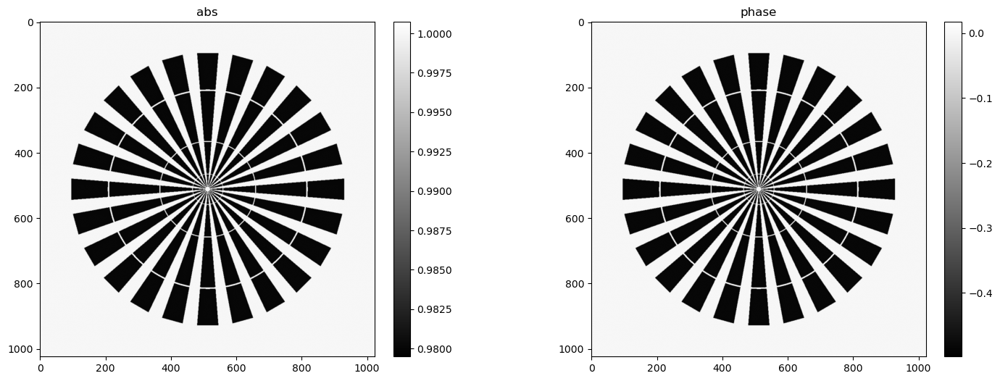

In [8]:
npsi = args.npsi
img = np.zeros((npsi, npsi, 3), np.uint8)
triangle = np.array([(1.5*npsi//16, npsi//2-npsi//32), (1.5*npsi//16, npsi//2+npsi//32), (npsi//2-npsi//128, npsi//2)], np.float32)
star = img[:,:,0]*0
for i in range(0, 360, 15):
    img = np.zeros((npsi, npsi, 3), np.uint8)
    degree = i
    theta = degree * np.pi / 180
    rot_mat = np.array([[np.cos(theta), -np.sin(theta)],
                        [np.sin(theta), np.cos(theta)]], np.float32)    
    rotated = cv2.gemm(triangle-npsi//2, rot_mat, 1, None, 1, flags=cv2.GEMM_2_T)+npsi//2
    cv2.fillPoly(img, [np.int32(rotated)], (255, 0, 0))
    star+=img[:,:,0]
[x,y] = np.meshgrid(np.arange(-npsi//2,npsi//2),np.arange(-npsi//2,npsi//2))
x = x/npsi*2
y = y/npsi*2
# add holes in triangles
circ = (x**2+y**2>0.355)+(x**2+y**2<0.345)
circ *= (x**2+y**2>0.083)+(x**2+y**2<0.08)
circ *= (x**2+y**2>0.0085)+(x**2+y**2<0.008)
star = star*circ/255

v = np.arange(-npsi//2,npsi//2)/npsi
[vx,vy] = np.meshgrid(v,v)
v = np.exp(-5*(vx**2+vy**2))
fu = np.fft.fftshift(np.fft.fftn(np.fft.fftshift(star)))
star = np.fft.fftshift(np.fft.ifftn(np.fft.fftshift(fu*v))).real


delta = 1-xraylib.Refractive_Index_Re('Au',energy,19.3)
beta = xraylib.Refractive_Index_Im('Au',energy,19.3)

thickness = 1e-6/voxelsize # siemens star thickness in pixels
# form Transmittance function
u = star*(-delta+1j*beta) # note -delta
Ru = u*thickness 
psi = np.exp(1j * Ru * voxelsize * 2 * np.pi / wavelength)[np.newaxis].astype('complex64')
psi = cp.array(psi[0])


mshow_polar(psi,True)

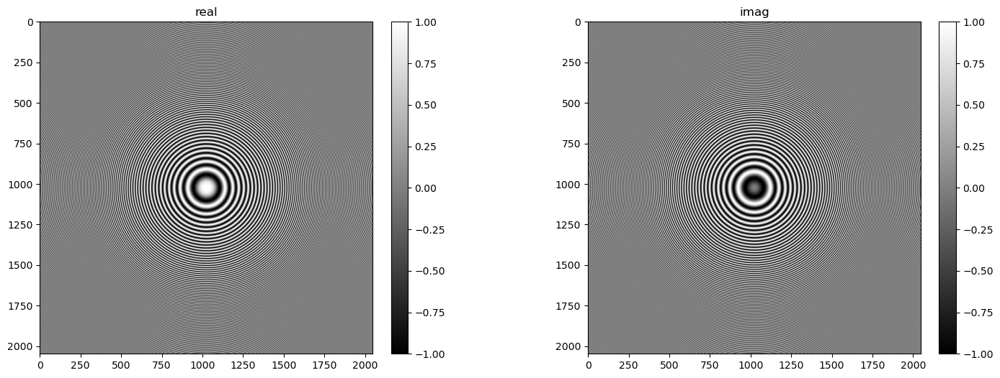

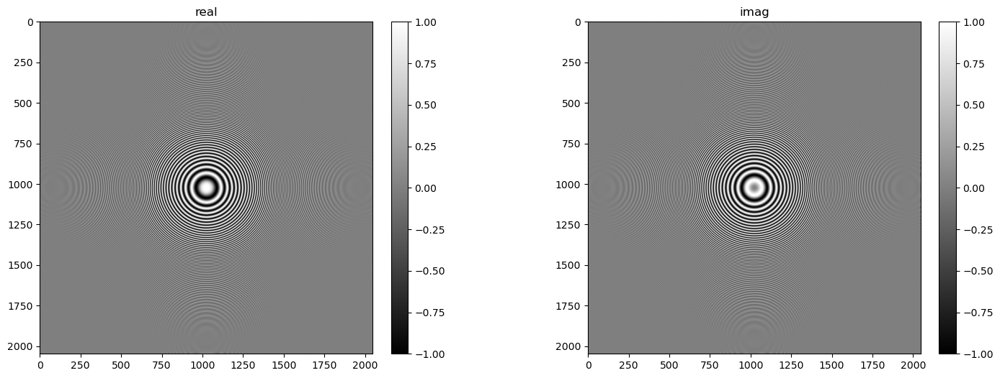

In [9]:

fx = cp.fft.fftfreq(npsi * 2, d=voxelsize).astype("float32")
[fx, fy] = cp.meshgrid(fx, fx)
fker = cp.exp(-1j * cp.pi * wavelength * distance * (fx**2 + fy**2))
mshow_complex(cp.fft.fftshift(fker),True)

fx = cp.fft.fftfreq(npsi * 2, d=voxelsize).astype("float32")
[fx, fy] = cp.meshgrid(fx, fx)
fkerc = cp.exp(-1j * cp.pi * wavelength * distancec * (fx**2 + fy**2))
mshow_complex(cp.fft.fftshift(fkerc),True)

## simulate data and reference image

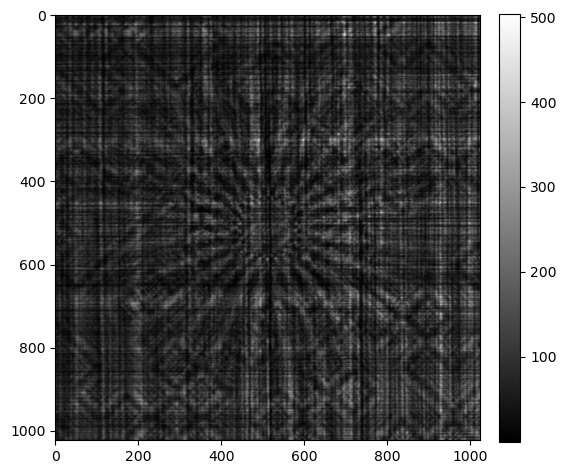

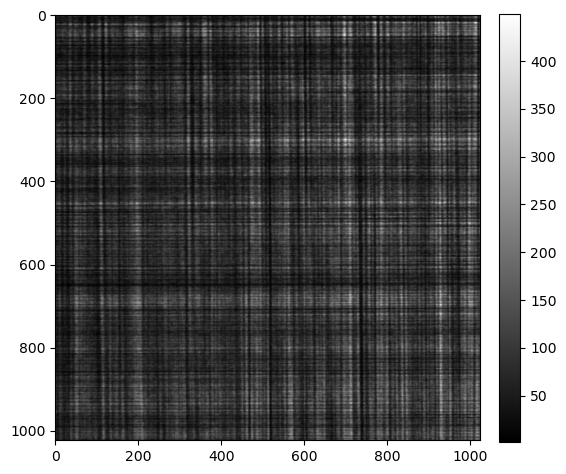

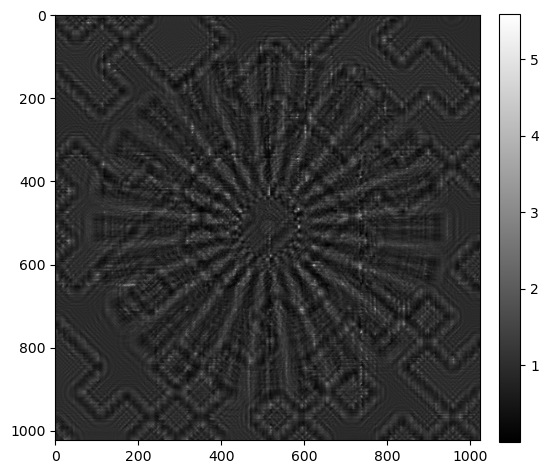

In [10]:
ri = np.round(pos).astype('int32')
r = (pos-ri).astype('float32')
data = np.abs(cl_rec.fwd(ri,r,code,psi,q))**2
ref = (np.abs(cl_rec.fwd(ri,r,code*0+1,psi*0+1,q))**2)[0]
mshow(data[0])
mshow(ref)
mshow(data[0]/ref)

# Reconstruction

## init probe by propagting it the reference image

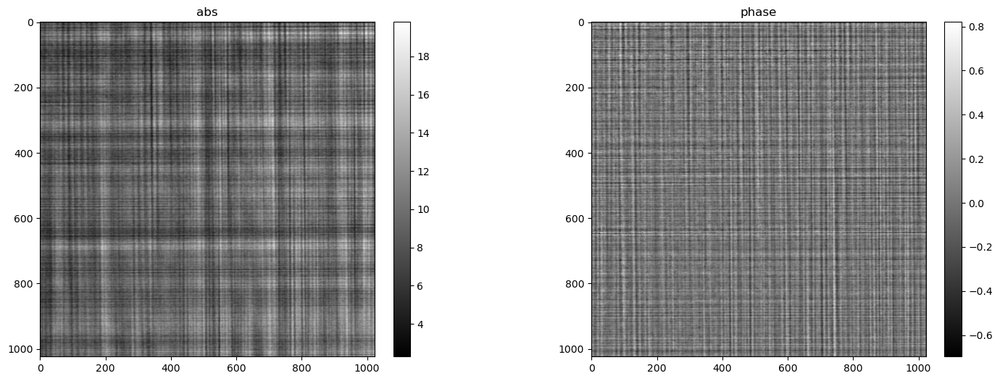

In [11]:
q_init = cp.array(cl_rec.DcT(cl_rec.DT(np.sqrt(ref[np.newaxis])))[0])

ppad = 3 * args.pad // 2
q_init = np.pad(
    q_init[ppad : args.npsi - ppad, ppad : args.npsi - ppad],
    ((ppad, ppad), (ppad, ppad)),
    "symmetric",
)
q_init = q_init.get()
mshow_polar(q_init)

# Reconstruction by the BH method

0) err=1.80428e+07


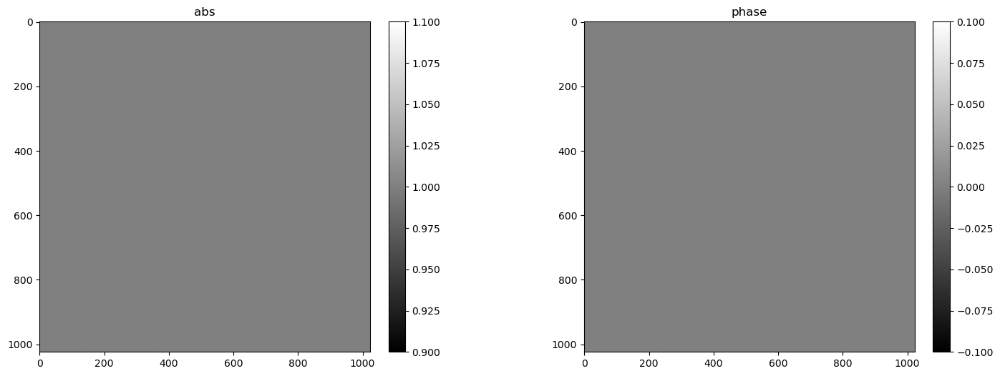

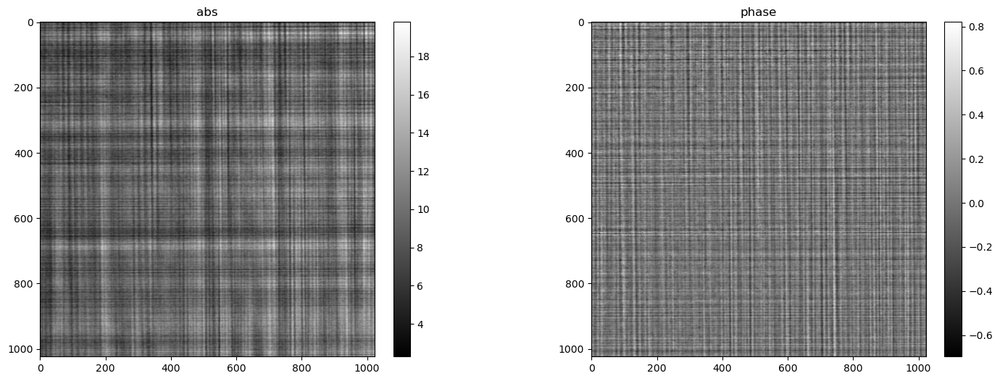

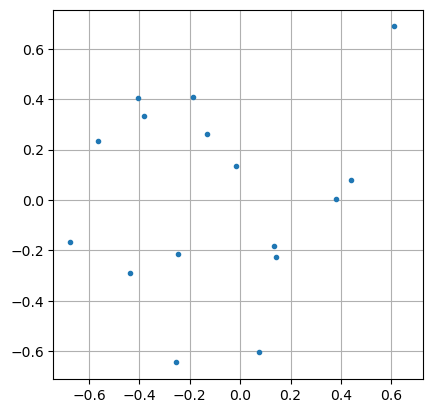

False
False


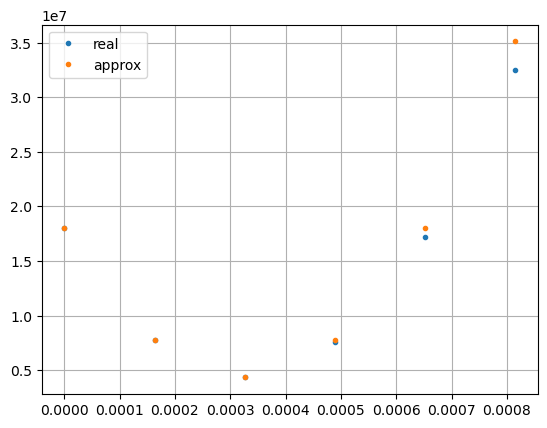

8) err=1.91639e+06
16) err=1.36266e+06


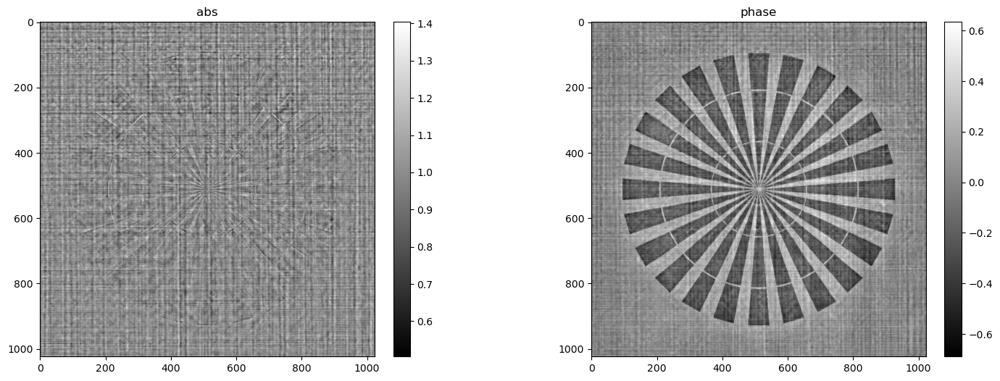

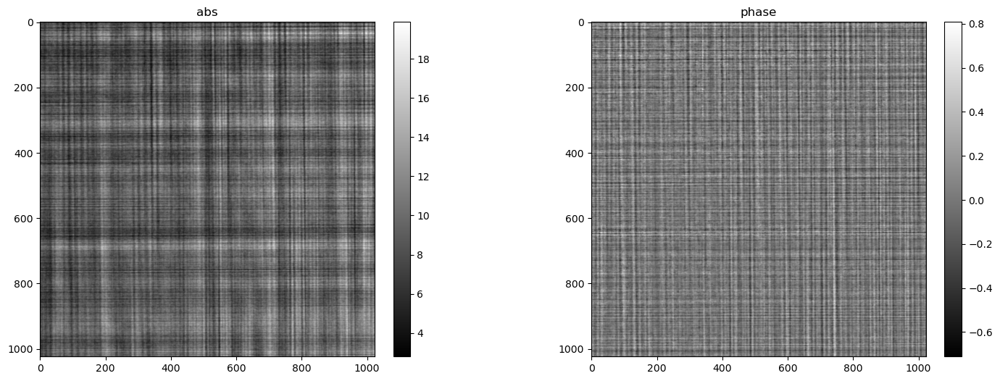

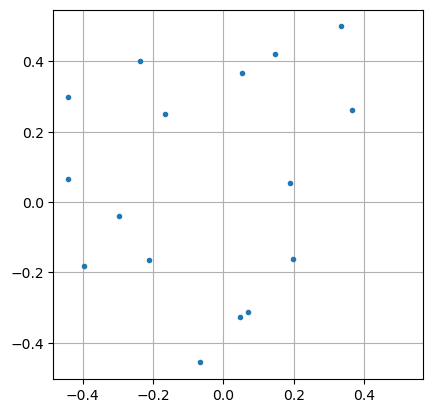

False
False


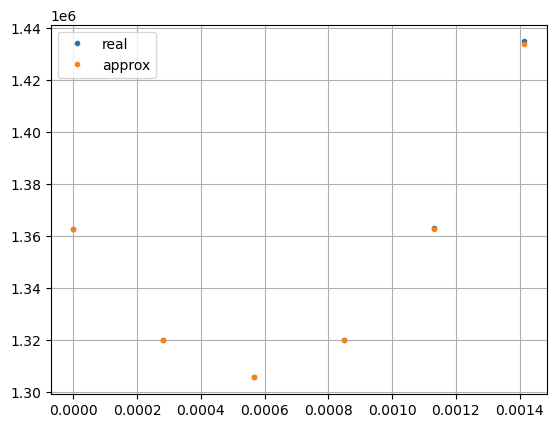

24) err=1.02441e+06
32) err=7.88148e+05


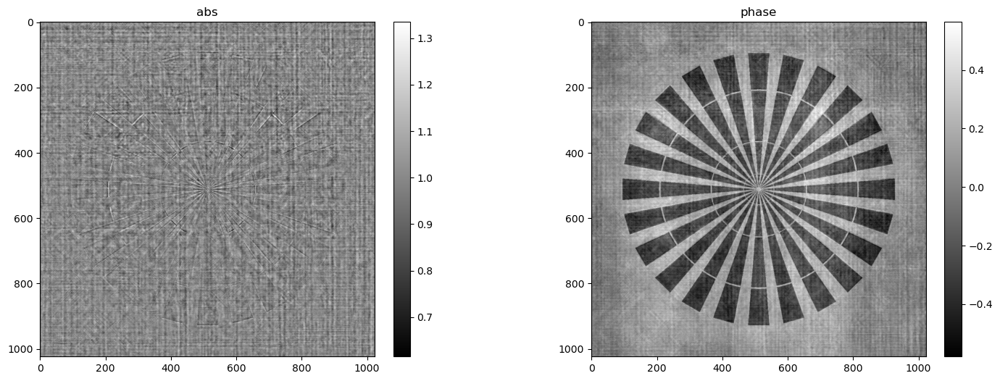

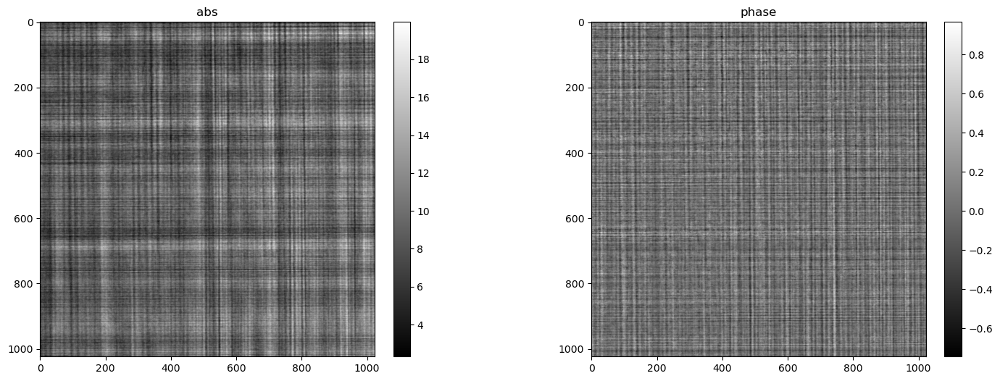

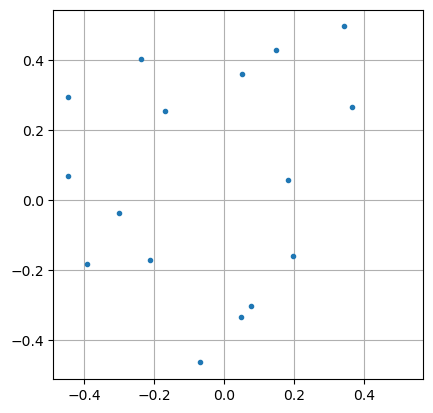

False
False


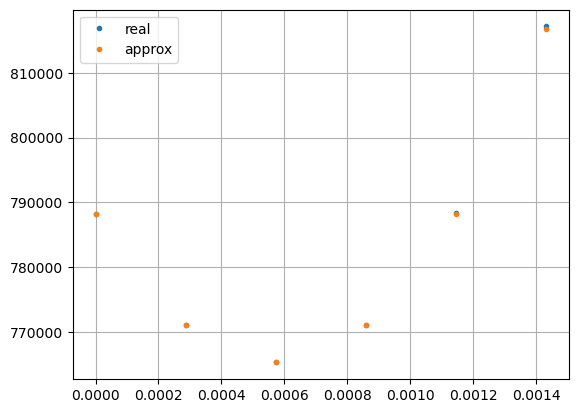

40) err=6.36889e+05
48) err=5.26143e+05


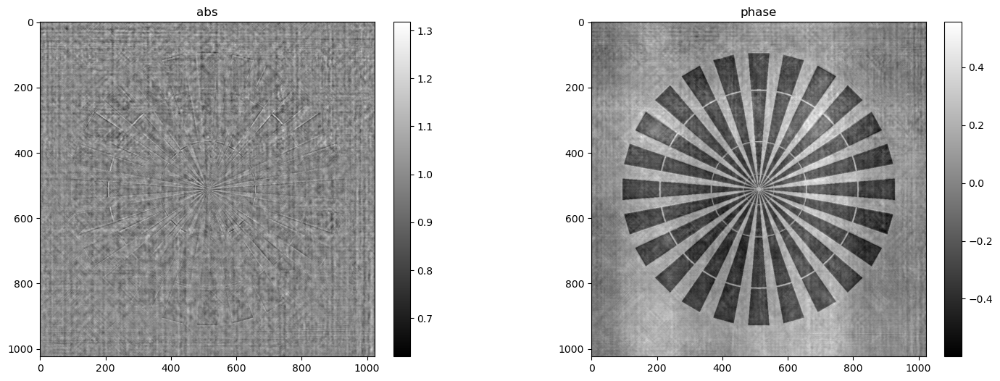

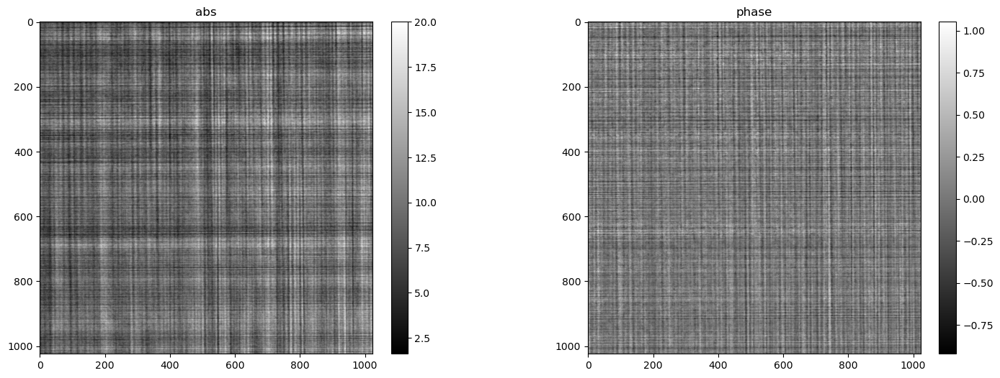

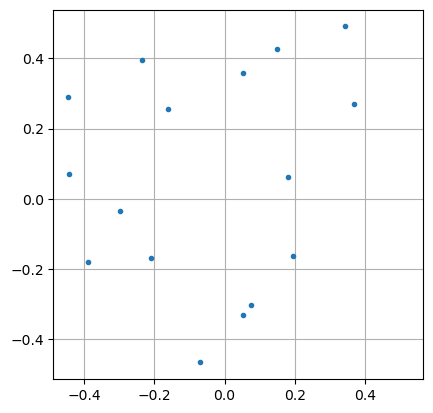

False
False


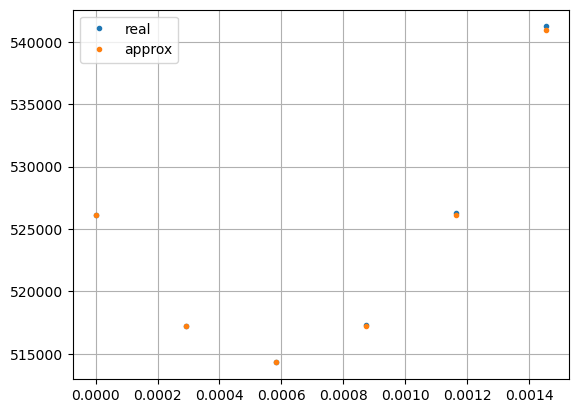

56) err=4.48921e+05
64) err=4.00179e+05


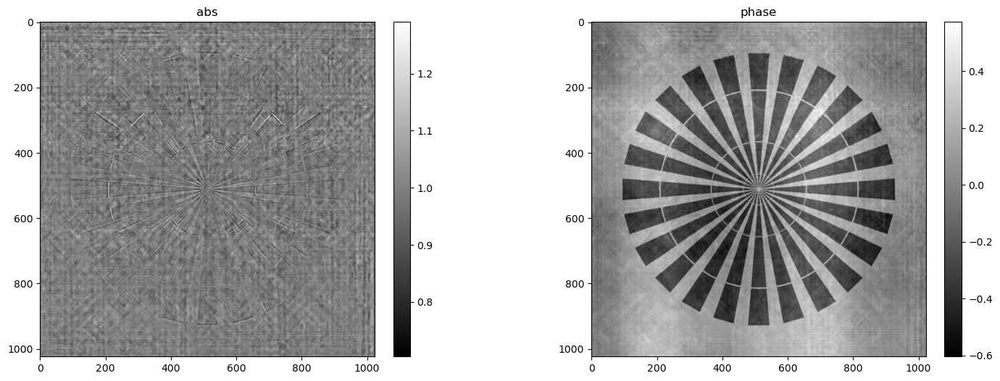

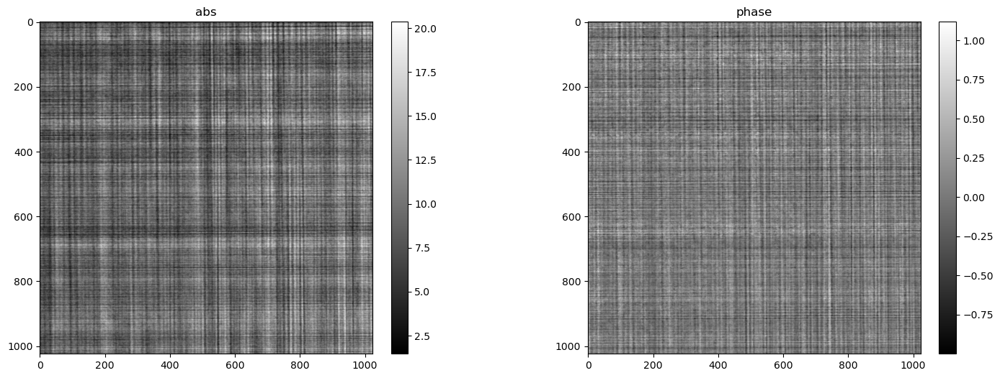

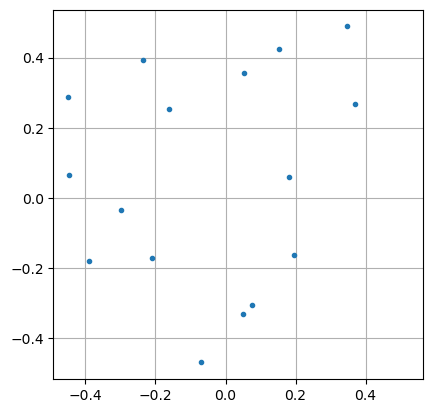

False
False


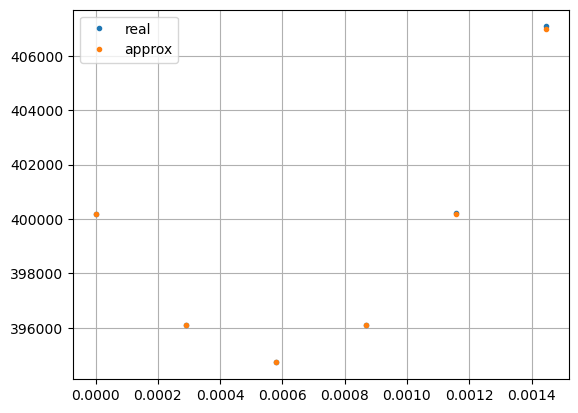

72) err=3.57555e+05
80) err=3.21717e+05


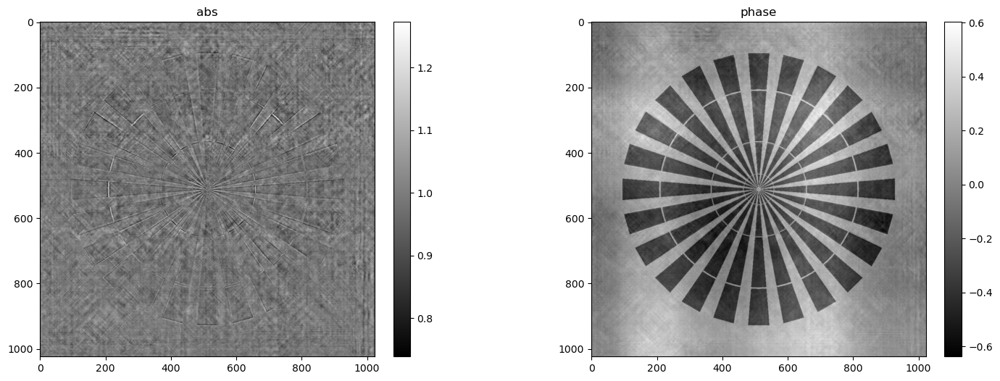

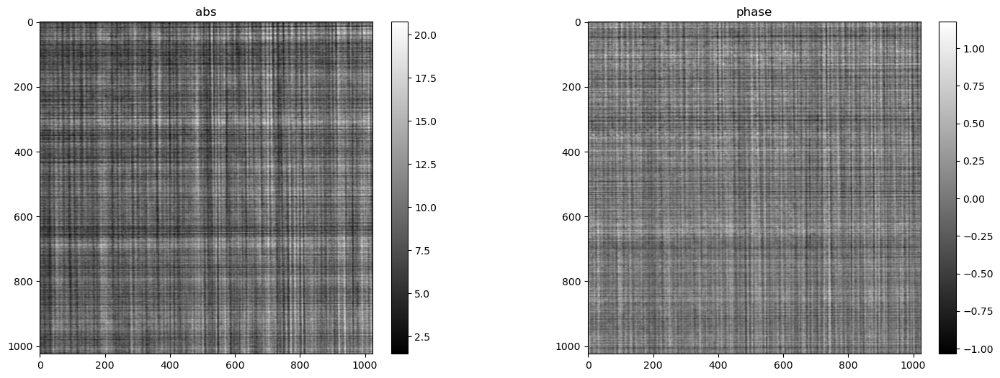

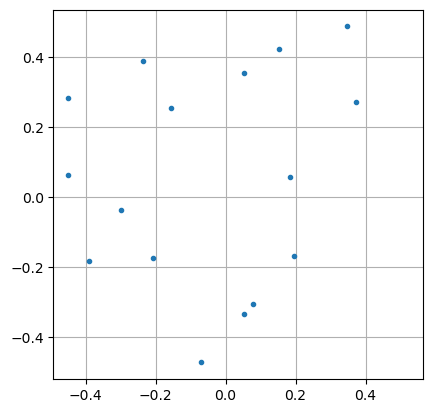

False
False


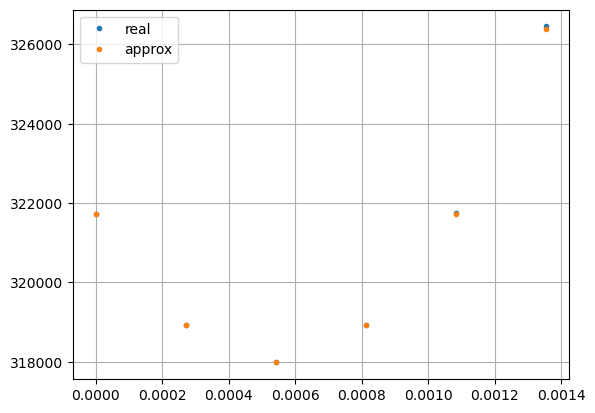

88) err=2.94164e+05
96) err=2.68118e+05


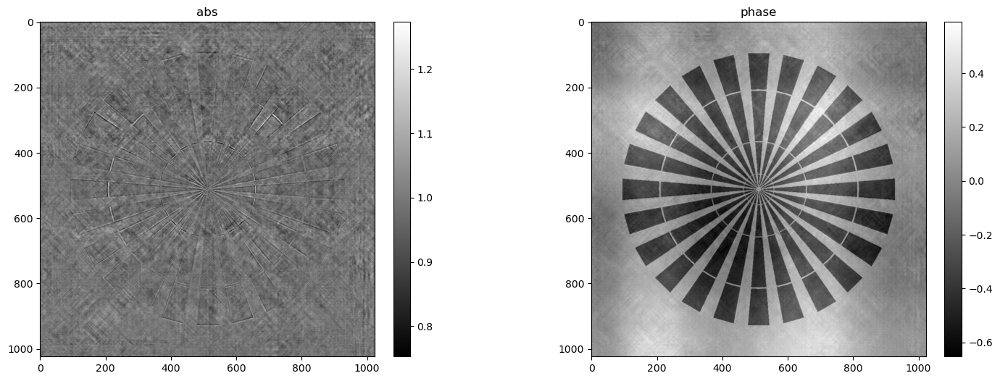

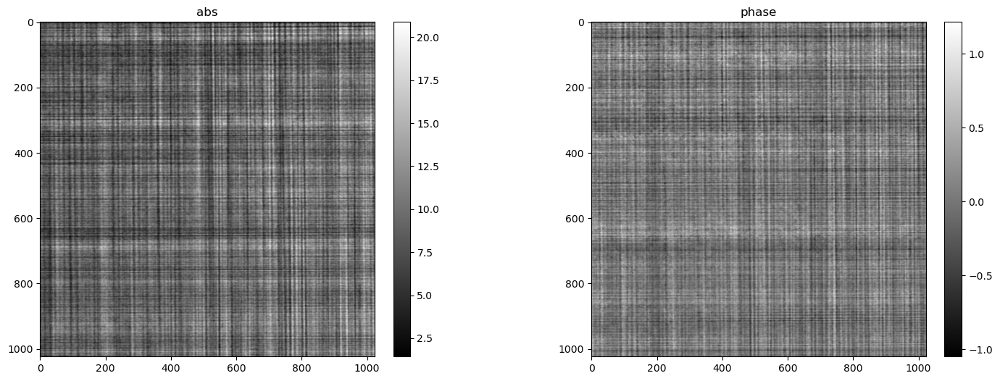

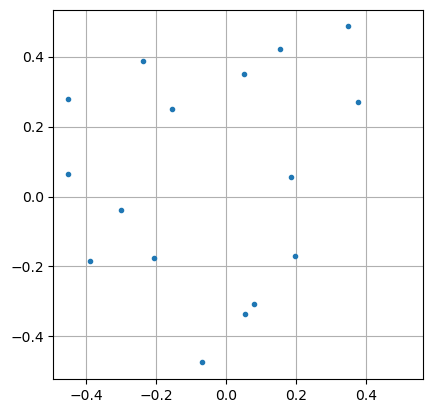

False
False


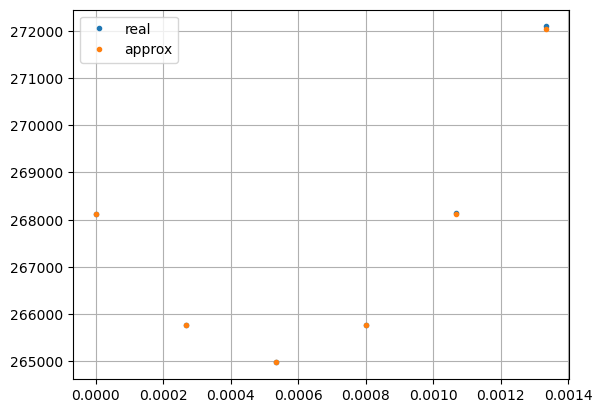

104) err=2.45564e+05
112) err=2.26692e+05


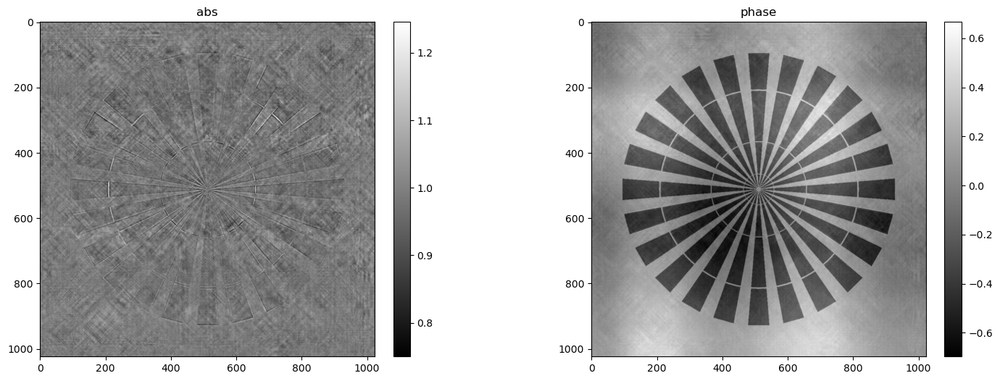

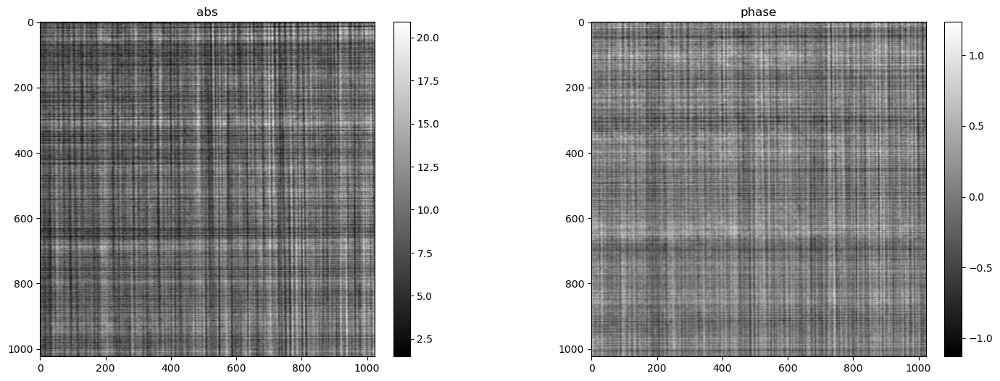

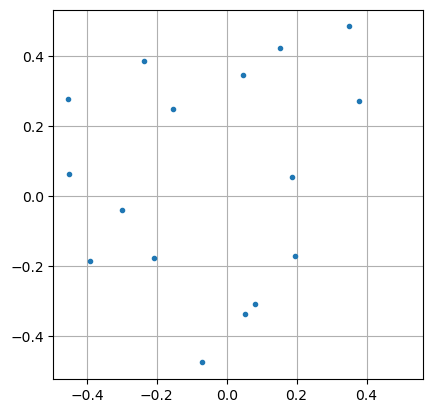

False
False


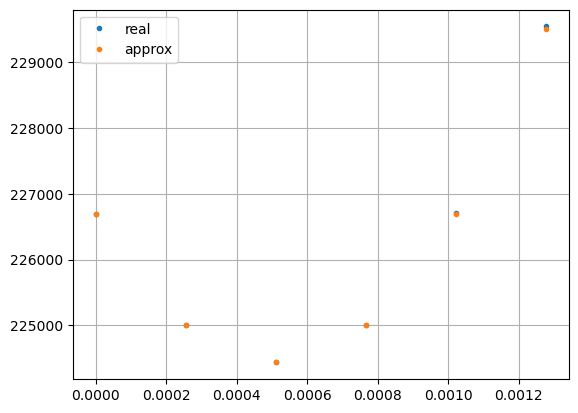

120) err=2.08165e+05
128) err=1.91506e+05


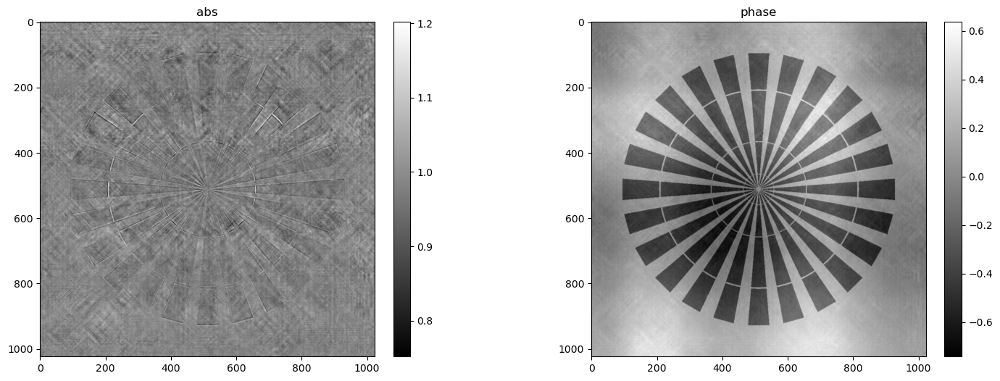

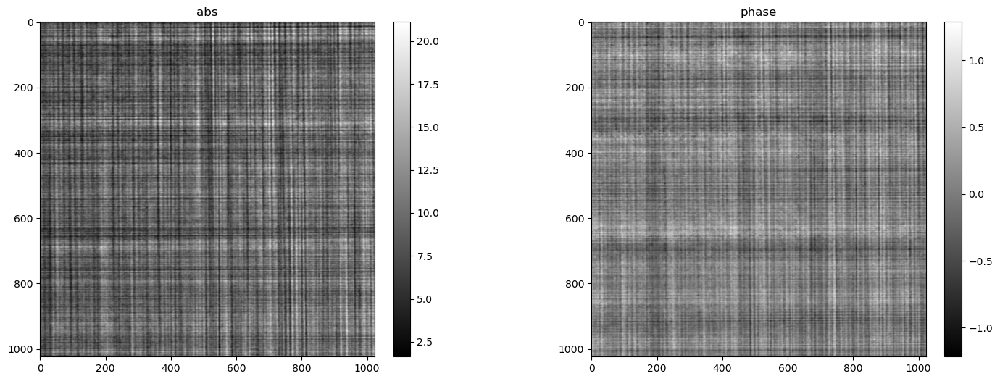

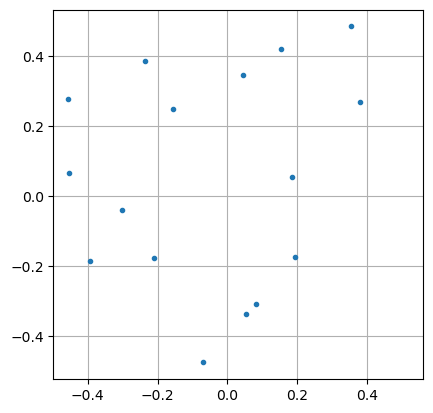

False
False


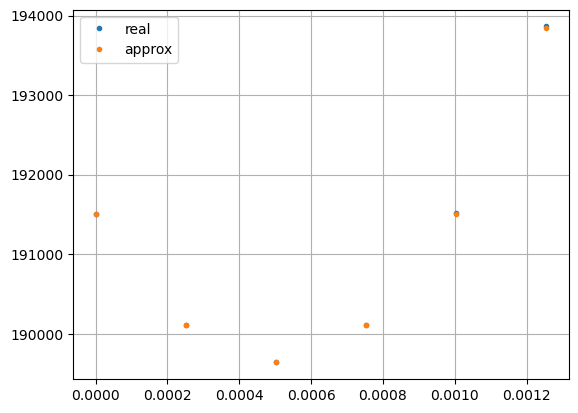

136) err=1.77191e+05
144) err=1.62908e+05


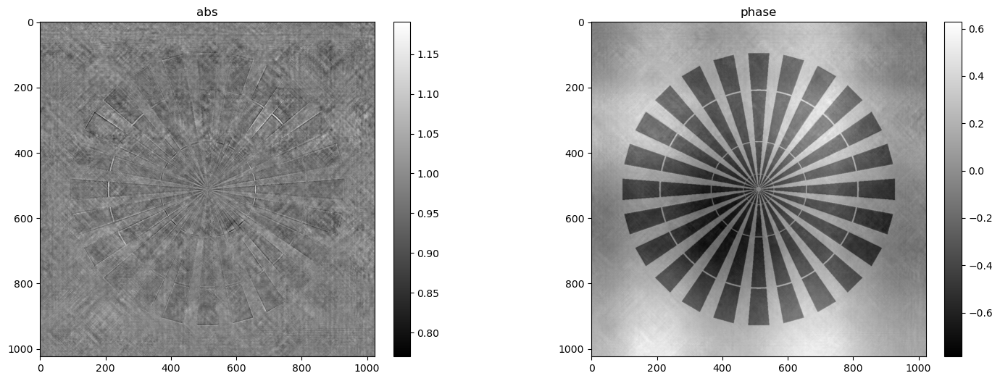

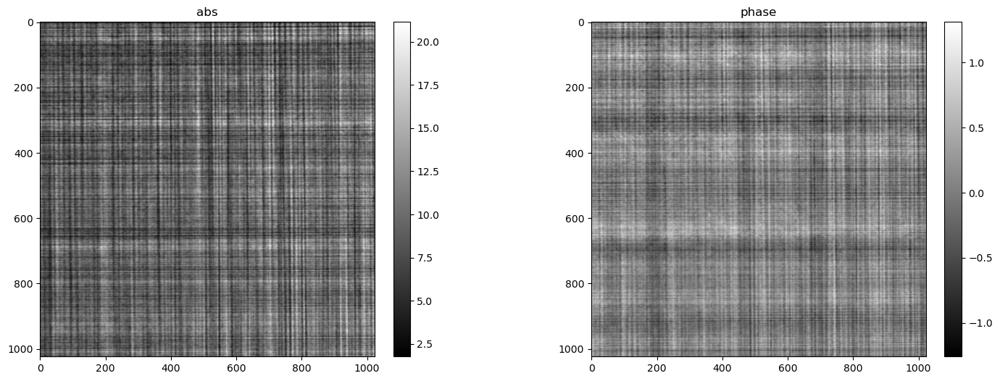

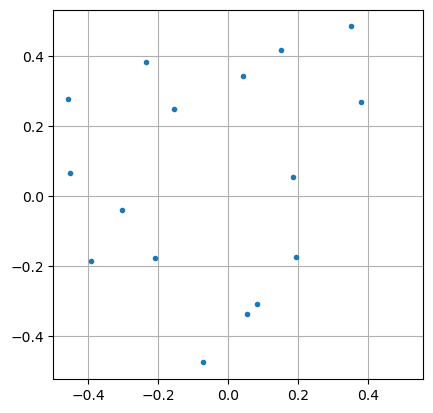

False
False


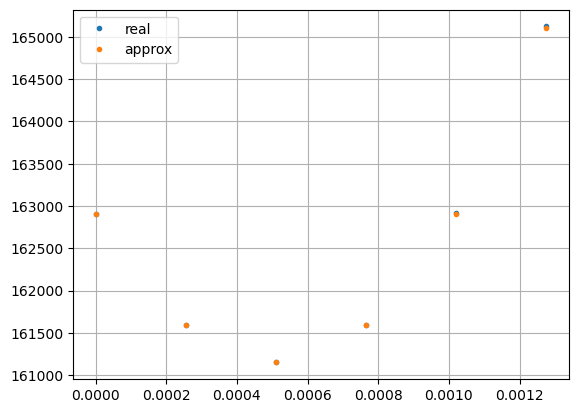

152) err=1.49952e+05
160) err=1.38521e+05


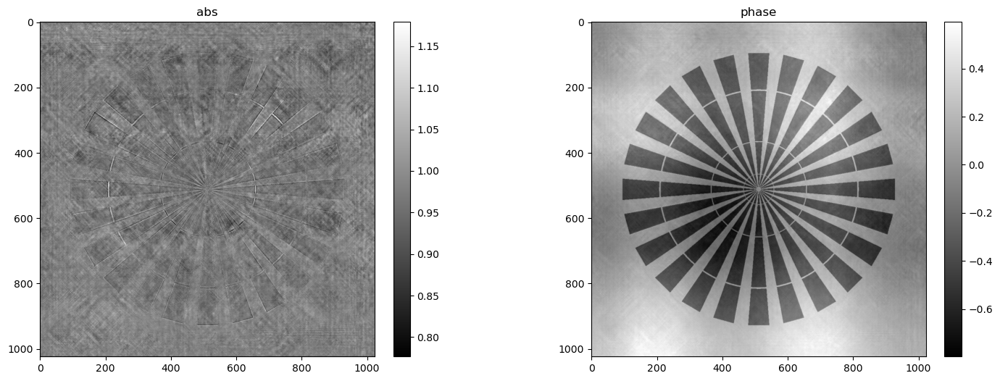

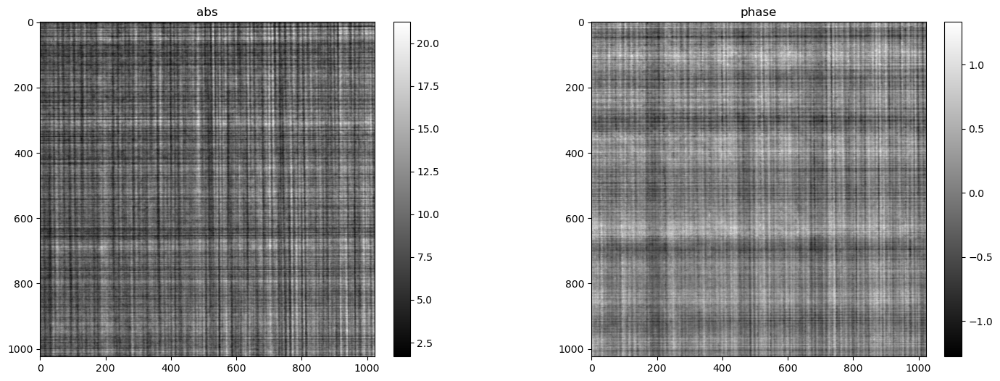

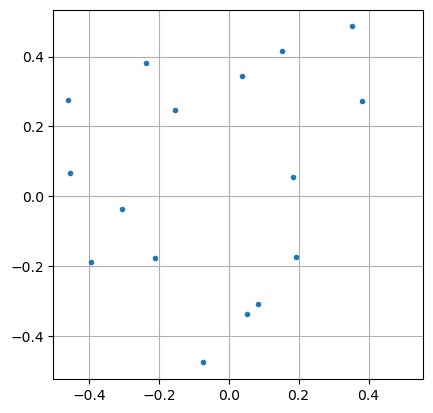

False
False


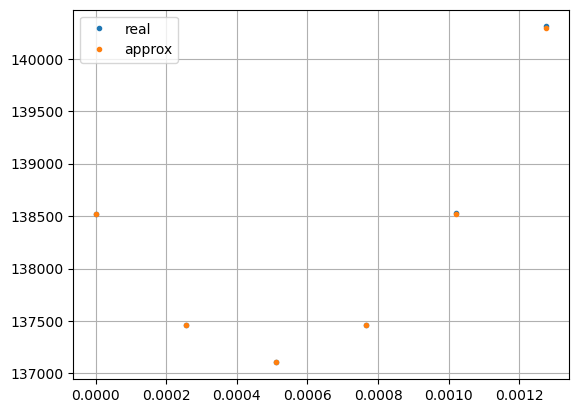

168) err=1.27465e+05
176) err=1.17282e+05


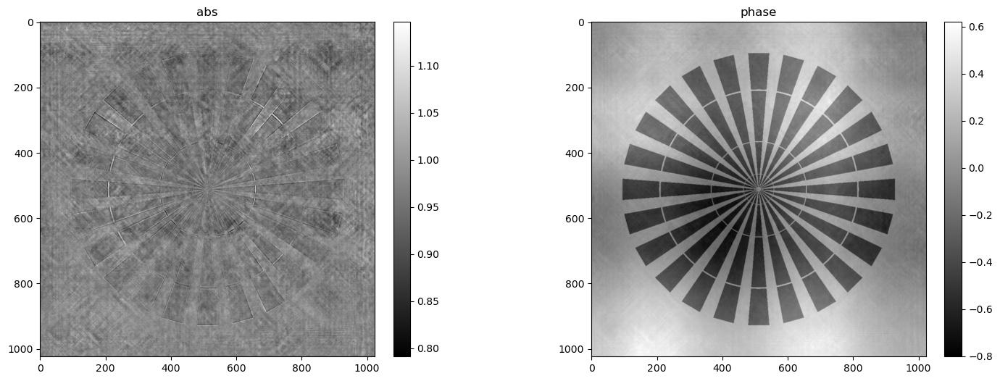

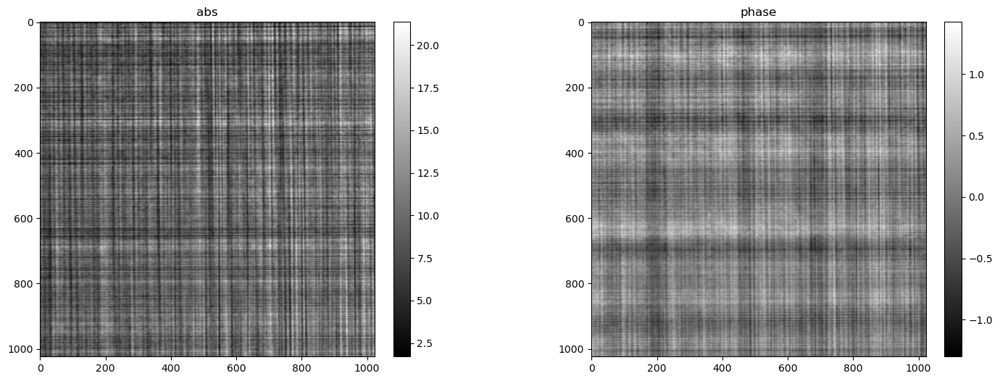

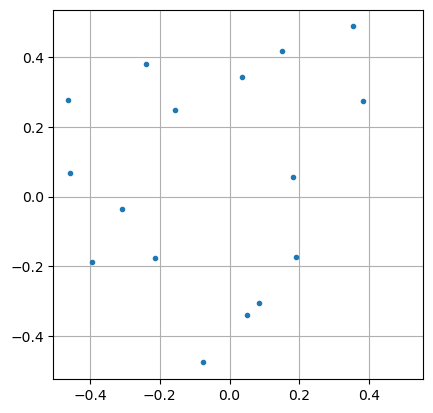

False
False


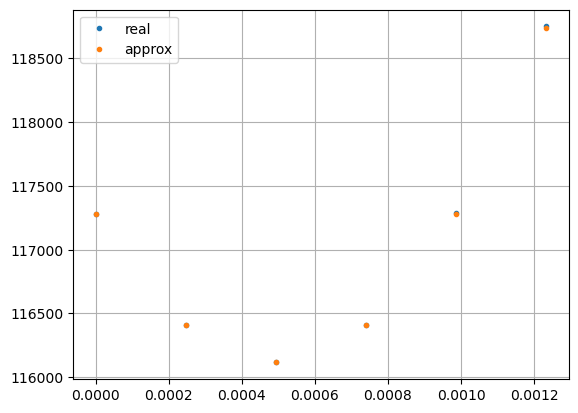

184) err=1.08477e+05
192) err=1.00129e+05


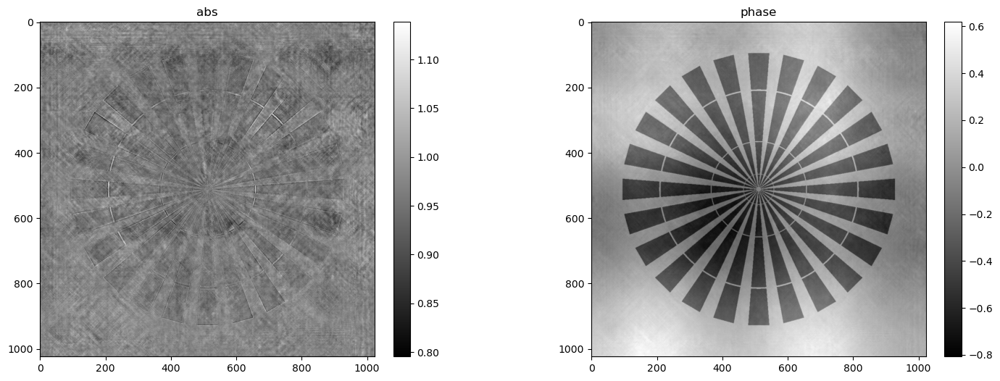

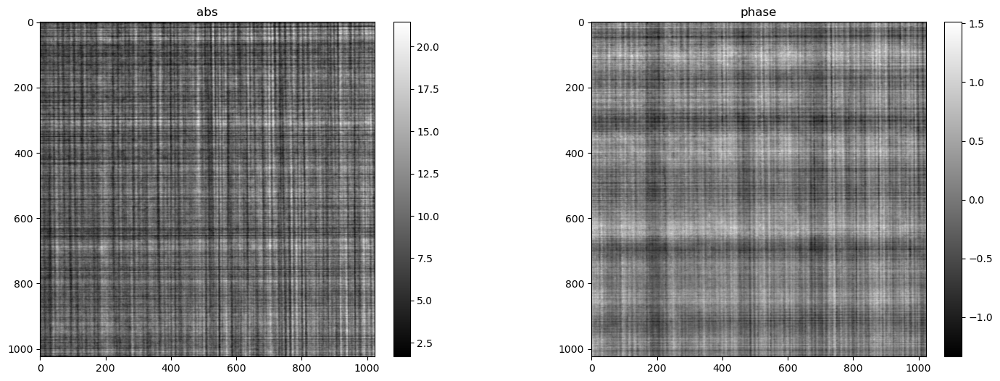

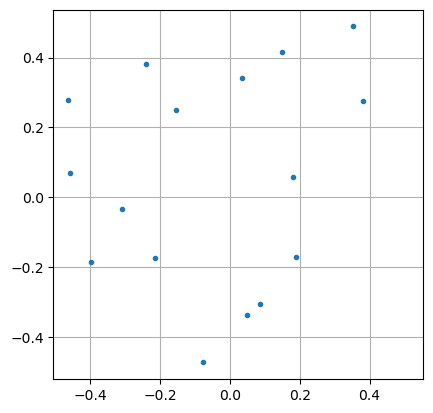

False
False


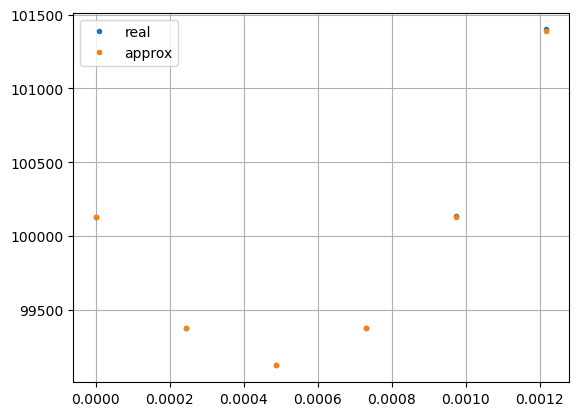

200) err=9.25207e+04
208) err=8.59996e+04


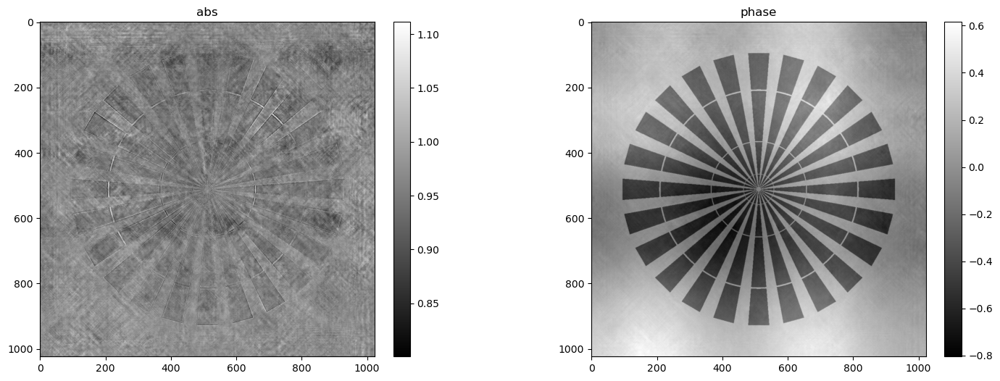

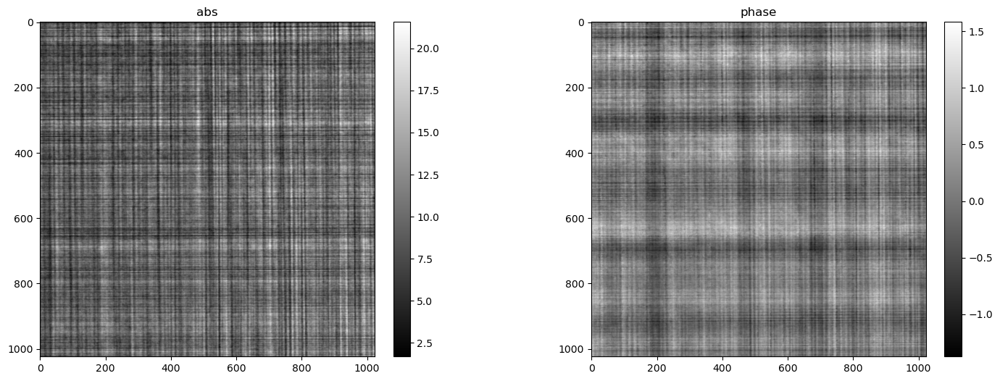

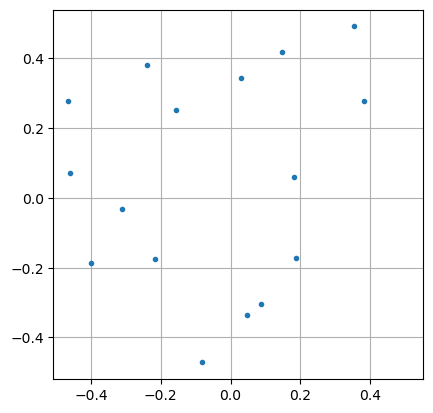

False
False


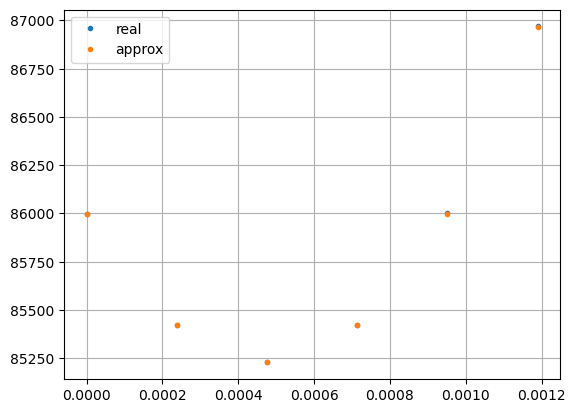

216) err=7.99850e+04
224) err=7.44775e+04


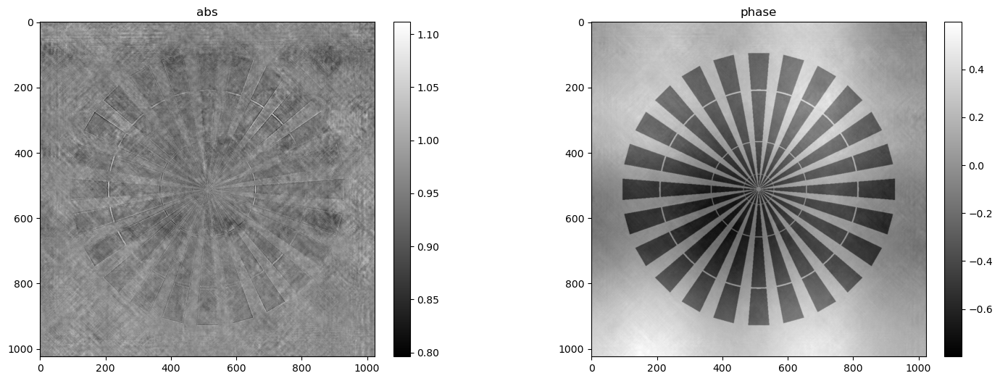

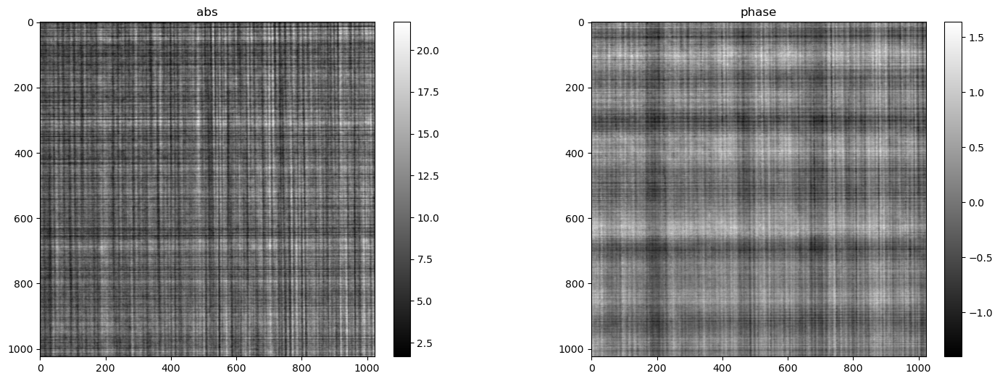

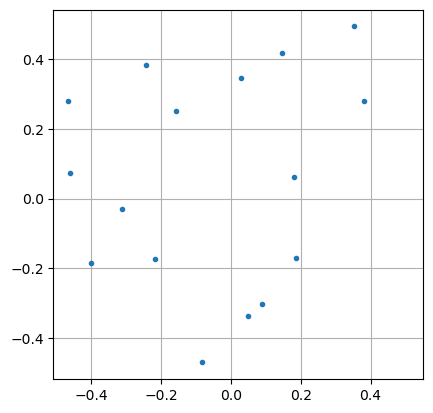

False
False


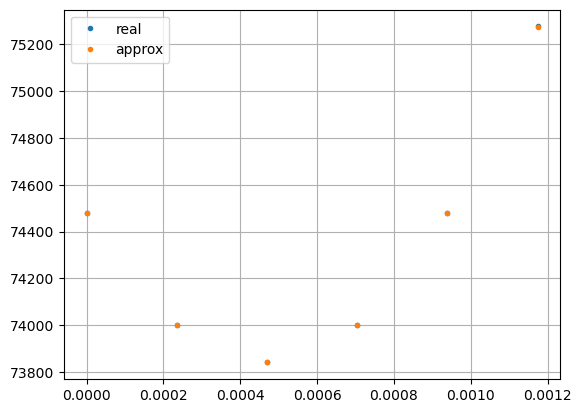

232) err=6.97592e+04
240) err=6.54466e+04


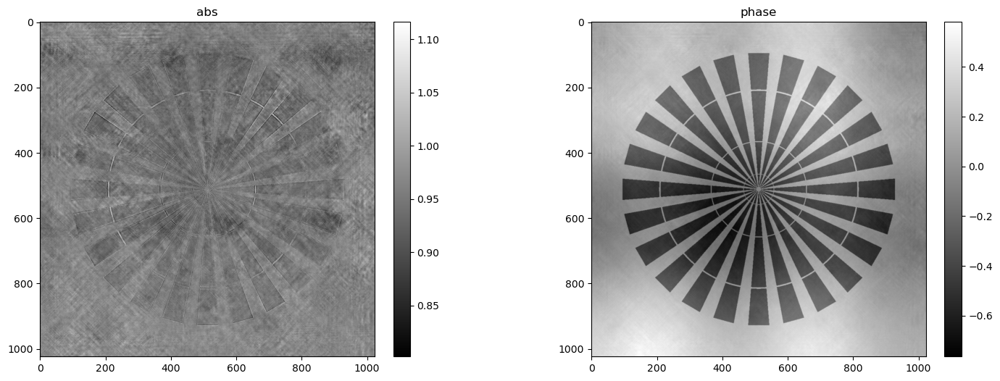

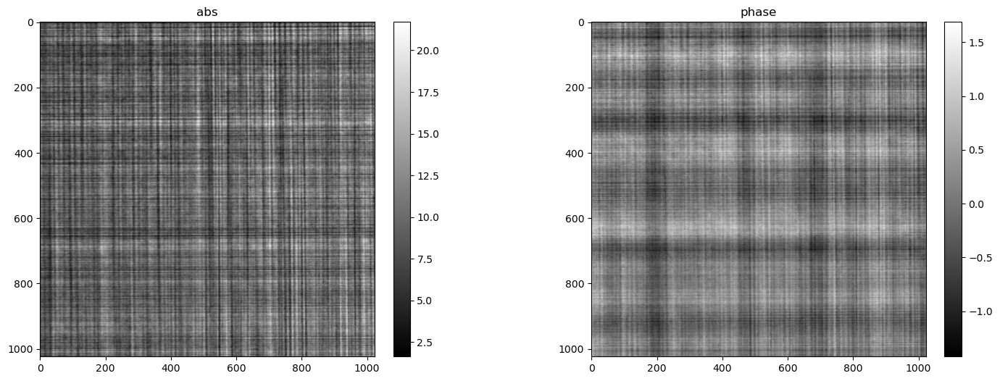

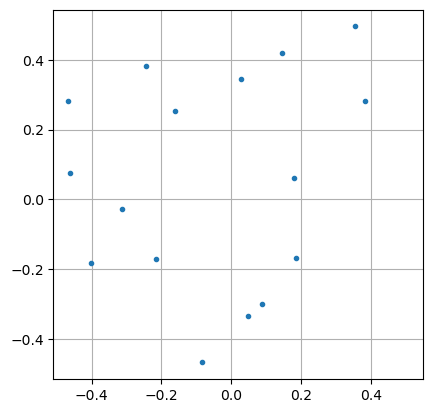

False
False


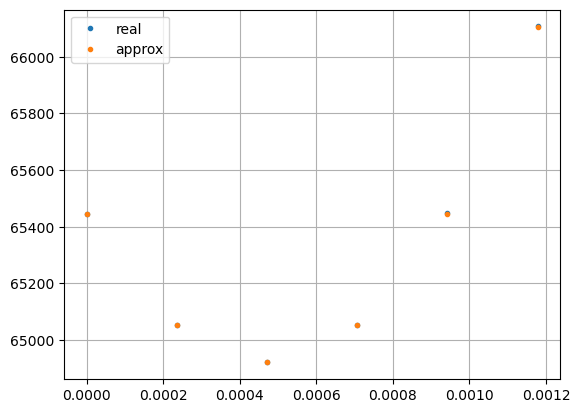

248) err=6.15142e+04
256) err=5.80641e+04


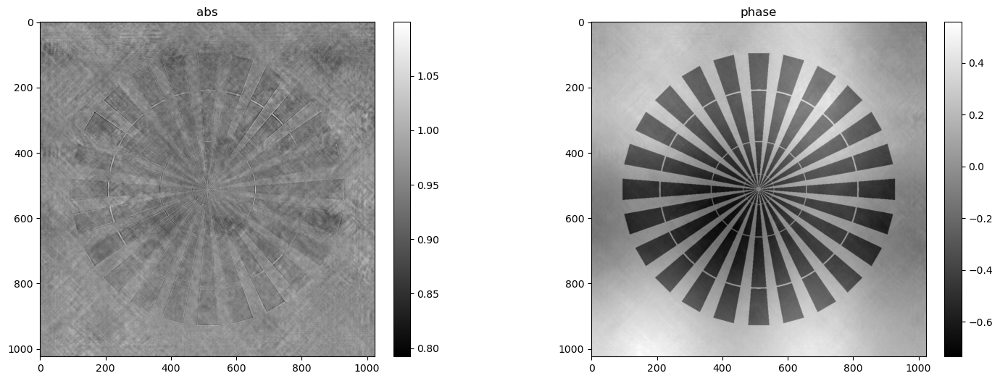

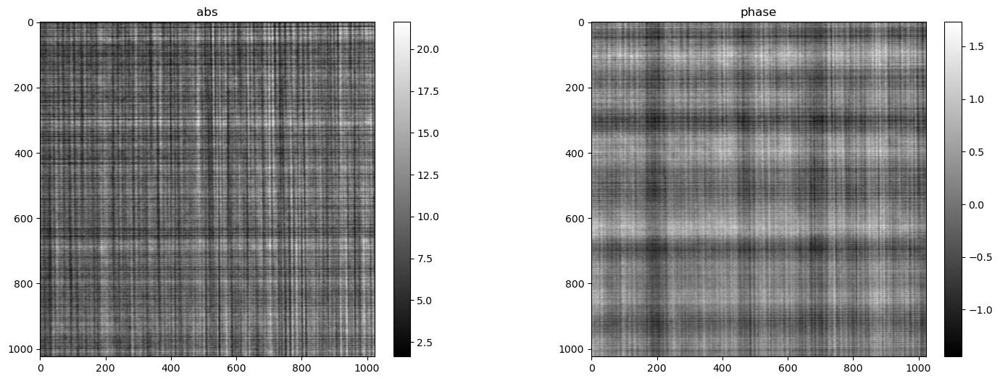

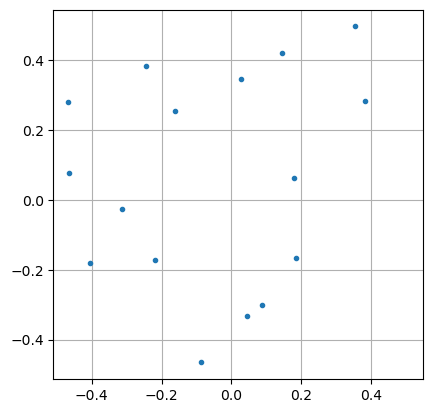

False
False


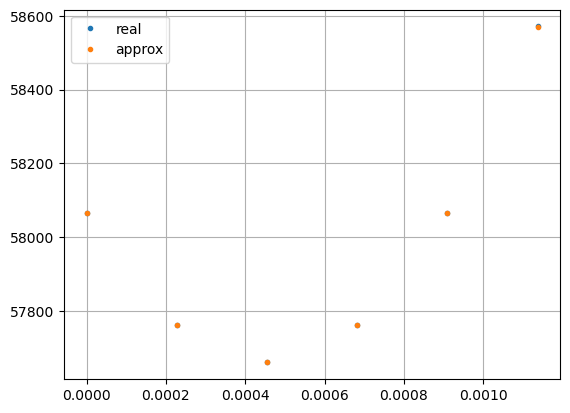

In [12]:
# variables
vars = {}
vars["psi"] = np.ones([args.npsi,args.npsi],dtype='complex64')
vars["q"] = cp.array(q_init.copy())
vars["code"] = code
vars["ri"] = np.round(pos).astype("int32")
vars["r_init"] = (pos - vars["ri"]).astype("float32")
vars["r"] = vars["r_init"].copy()+(np.random.random([npos,2])-0.5).astype('float32')
vars["table"] = pd.DataFrame(columns=["iter", "err", "time"])

cl_rec.rho = [1,2,0.1]
cl_rec.niter = 513
cl_rec.vis_step = 32
cl_rec.err_step = 8
cl_rec.eps = 0
cl_rec.lam = 0
cl_rec.path_out = "/data/tmp/"
cl_rec.show = True

# reconstruction
vars = cl_rec.BH(data, vars)